# Regression Mini Project on Training Data Set

### Importing all the necessary modules

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt          
import datetime as dt 
import scipy.stats as stats
import statsmodels.formula.api as smf

### Importing the data from an external source into the Python environment

In [2]:
data = pd.read_excel('Training Data Set .xlsx')
data.head()

,Date,Year,Month,Customer Age,Customer Gender,Country,State,Product Category,Sub Category,Quantity,Unit Cost,Unit Price,Cost,Revenue
0,2016-02-19,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,1,80.00,109.000000,80,109
1,2016-02-20,2016,February,29,F,United States,Washington,Clothing,Gloves,2,24.50,28.500000,49,57
2,2016-02-27,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,3,3.67,5.000000,11,15
3,2016-03-12,2016,March,29,F,United States,Washington,Accessories,Tires and Tubes,2,87.50,116.500000,175,233
4,2016-03-12,2016,March,29,F,United States,Washington,Accessories,Tires and Tubes,3,35.00,41.666667,105,125


In [3]:
data.shape

(34866, 14)

In [4]:
data.head(3)

,Date,Year,Month,Customer Age,Customer Gender,Country,State,Product Category,Sub Category,Quantity,Unit Cost,Unit Price,Cost,Revenue
0,2016-02-19,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,1,80.00,109.0,80,109
1,2016-02-20,2016,February,29,F,United States,Washington,Clothing,Gloves,2,24.50,28.5,49,57
2,2016-02-27,2016,February,29,F,United States,Washington,Accessories,Tires and Tubes,3,3.67,5.0,11,15


### Renaming the variables as per the Naming conversion

In [5]:
data.columns

Index(['Date', 'Year', 'Month', 'Customer Age', 'Customer Gender', 'Country',
       'State', 'Product Category', 'Sub Category', 'Quantity', 'Unit Cost',
       'Unit Price', 'Cost', 'Revenue'],
      dtype='object')

In [6]:
data.columns = [i.replace(' ','_') for i in data.columns]
data.columns

Index(['Date', 'Year', 'Month', 'Customer_Age', 'Customer_Gender', 'Country',
       'State', 'Product_Category', 'Sub_Category', 'Quantity', 'Unit_Cost',
       'Unit_Price', 'Cost', 'Revenue'],
      dtype='object')

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34866 entries, 0 to 34865
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Date              34866 non-null  datetime64[ns]
 1   Year              34866 non-null  int64         
 2   Month             34866 non-null  object        
 3   Customer_Age      34866 non-null  int64         
 4   Customer_Gender   34866 non-null  object        
 5   Country           34866 non-null  object        
 6   State             34866 non-null  object        
 7   Product_Category  34866 non-null  object        
 8   Sub_Category      34866 non-null  object        
 9   Quantity          34866 non-null  int64         
 10  Unit_Cost         34866 non-null  float64       
 11  Unit_Price        34866 non-null  float64       
 12  Cost              34866 non-null  int64         
 13  Revenue           34866 non-null  int64         
dtypes: datetime64[ns](1), 

### Data Duplicacy: Chech if their is duplicate data or not

In [8]:
data.duplicated().sum()

1

In [9]:
data.drop_duplicates(inplace=True)

In [10]:
data.duplicated().sum()

0

In [11]:
data.isna().sum()

Date                0
Year                0
Month               0
Customer_Age        0
Customer_Gender     0
Country             0
State               0
Product_Category    0
Sub_Category        0
Quantity            0
Unit_Cost           0
Unit_Price          0
Cost                0
Revenue             0
dtype: int64

### Outlier Treatment

In [12]:
num_data = data.select_dtypes(['int','float'])

In [13]:
num_data 

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue
0,2016,29,1,80.00,109.000000,80,109
1,2016,29,2,24.50,28.500000,49,57
2,2016,29,3,3.67,5.000000,11,15
3,2016,29,2,87.50,116.500000,175,233
4,2016,29,3,35.00,41.666667,105,125
...,...,...,...,...,...,...,...
34861,2015,38,1,2049.00,1487.000000,2049,1487
34862,2016,38,2,1160.00,985.500000,2320,1971
34863,2015,38,1,2049.00,1583.000000,2049,1583
34864,2015,38,3,683.00,560.666667,2049,1682


In [14]:
cat_data = data.select_dtypes(['object'])

In [15]:
num_data['index'] = num_data.index


In [16]:
num_data.shape

(34865, 8)

In [17]:
cat_data['index'] = cat_data.index

In [18]:
cat_data.shape

(34865, 7)

In [19]:
cat_data.head()

,Month,Customer_Gender,Country,State,Product_Category,Sub_Category,index
0,February,F,United States,Washington,Accessories,Tires and Tubes,0
1,February,F,United States,Washington,Clothing,Gloves,1
2,February,F,United States,Washington,Accessories,Tires and Tubes,2
3,March,F,United States,Washington,Accessories,Tires and Tubes,3
4,March,F,United States,Washington,Accessories,Tires and Tubes,4


<Axes: >

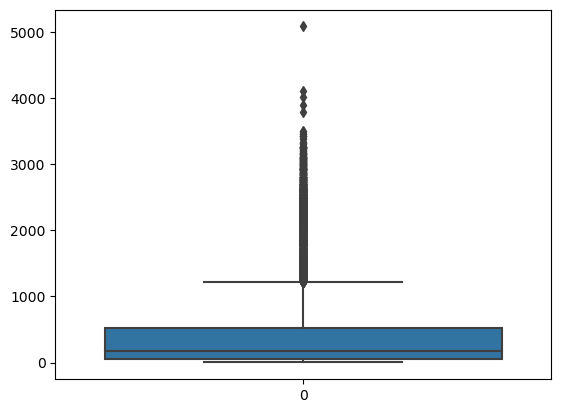

In [20]:
sns.boxplot(num_data.Unit_Price)

In [21]:
cat_data.Month.value_counts()

Month
June         3680
May          3676
December     3414
April        3283
March        3155
January      2907
February     2887
October      2554
November     2488
August       2303
September    2303
July         2215
Name: count, dtype: int64

In [22]:
cat_data.Month.nunique()

12

In [23]:
cat_data.Customer_Gender.value_counts()

Customer_Gender
M    17805
F    17060
Name: count, dtype: int64

In [24]:
cat_data.Customer_Gender.nunique()

2

In [25]:
cat_data.Country.value_counts()

Country
United States     18076
United Kingdom     6421
Germany            5200
France             5168
Name: count, dtype: int64

In [26]:
cat_data.Country.nunique()

4

In [27]:
cat_data.Product_Category.value_counts()

Product_Category
Accessories    22533
Bikes           7093
Clothing        5239
Name: count, dtype: int64

In [28]:
cat_data.Product_Category.nunique()

3

In [29]:
cat_data.Sub_Category.value_counts()

Sub_Category
Tires and Tubes      11112
Bottles and Cages     5294
Helmets               4176
Road Bikes            3022
Mountain Bikes        2737
Jerseys               2000
Caps                  1517
Touring Bikes         1334
Fenders                762
Shorts                 566
Cleaners               545
Gloves                 480
Hydration Packs        396
Socks                  364
Vests                  312
Bike Stands            145
Bike Racks             103
Name: count, dtype: int64

In [30]:
cat_data.Sub_Category.nunique()

17

<Axes: xlabel='Customer_Gender'>

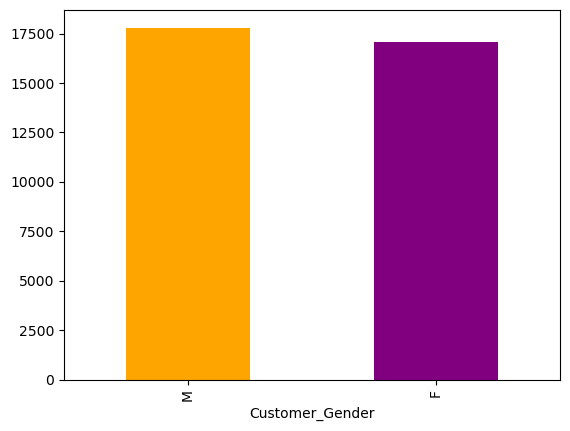

In [31]:
cat_data.Customer_Gender.value_counts().plot(kind = 'bar',color = ['orange','purple'])

<Axes: xlabel='Country'>

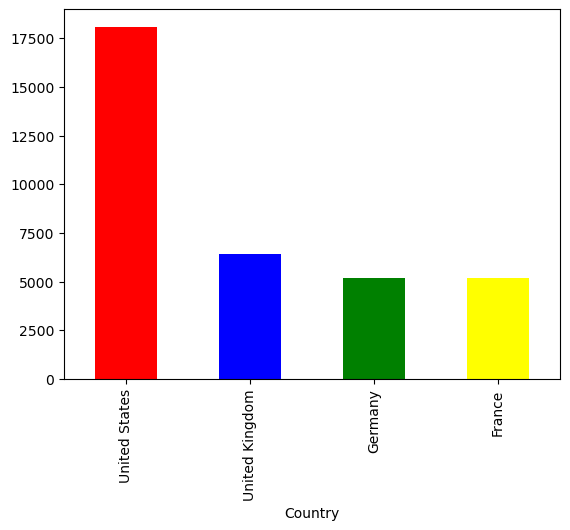

In [32]:
cat_data.Country.value_counts().plot(kind ='bar',color = ['red','blue','green','yellow'])

## One-hot encoding

In [33]:
cat_data.columns

Index(['Month', 'Customer_Gender', 'Country', 'State', 'Product_Category',
       'Sub_Category', 'index'],
      dtype='object')

In [34]:
cat_data.shape

(34865, 7)

In [35]:
cat_data = pd.get_dummies(cat_data,columns =['Customer_Gender','Country'],dtype=int)

In [36]:
cat_data.head()

,Month,State,Product_Category,Sub_Category,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States
0,February,Washington,Accessories,Tires and Tubes,0,1,0,0,0,0,1
1,February,Washington,Clothing,Gloves,1,1,0,0,0,0,1
2,February,Washington,Accessories,Tires and Tubes,2,1,0,0,0,0,1
3,March,Washington,Accessories,Tires and Tubes,3,1,0,0,0,0,1
4,March,Washington,Accessories,Tires and Tubes,4,1,0,0,0,0,1


In [37]:
cat_data.shape

(34865, 11)

In [38]:
cat_data = pd.get_dummies(cat_data,columns = ['Month','State', 'Product_Category','Sub_Category'],dtype = int)

In [39]:
cat_data.head()

,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,0,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,1,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,3,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,4,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [40]:
cat_data.shape

(34865, 84)

## Merging the num_data and the cat_data

In [41]:
num_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index
0,2016,29,1,80.00,109.000000,80,109,0
1,2016,29,2,24.50,28.500000,49,57,1
2,2016,29,3,3.67,5.000000,11,15,2
3,2016,29,2,87.50,116.500000,175,233,3
4,2016,29,3,35.00,41.666667,105,125,4


In [42]:
num_data.shape

(34865, 8)

In [43]:
cat_data.head()

,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,0,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,1,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,3,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,4,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [44]:
cat_data.shape

(34865, 84)

In [45]:
final_data = pd.merge(num_data,cat_data,how = 'inner',left_on = 'index',right_on = 'index')

In [46]:
final_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,0,1,0,0
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,0,1,0,0
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,0,1,0,0


In [47]:
final_data.shape

(34865, 91)

## Checking if the data is normally distributed or not

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


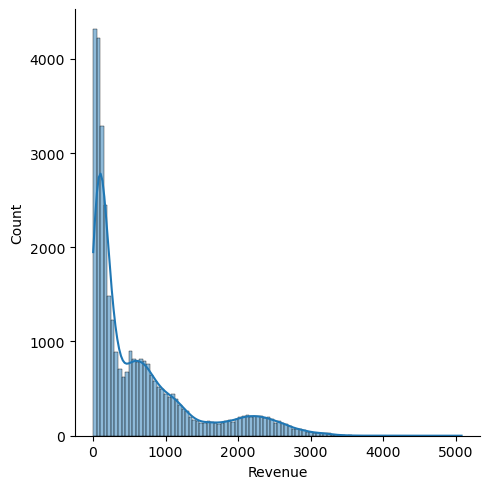

In [48]:
sns.displot(final_data.Revenue,kde = True)

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


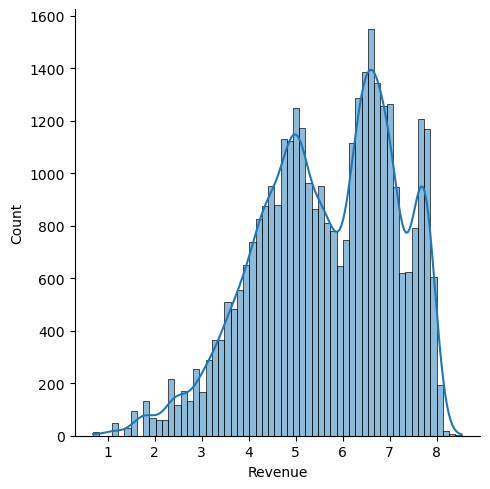

In [49]:
sns.displot(np.log(final_data.Revenue),kde = True)

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


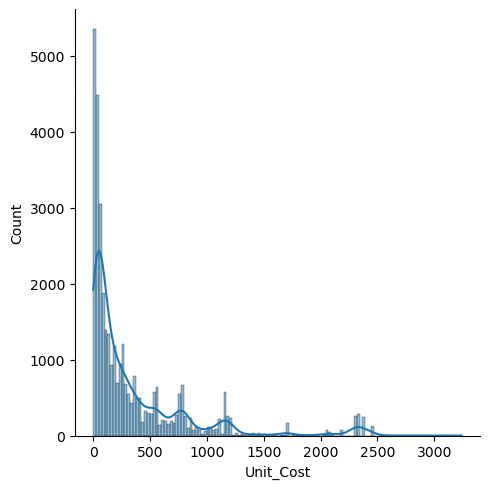

In [50]:
sns.displot(final_data.Unit_Cost,kde = True)

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


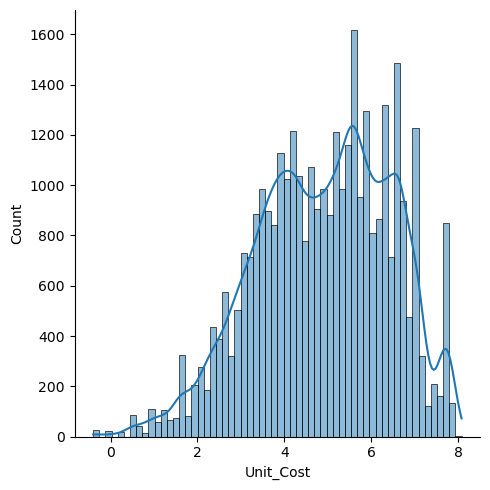

In [51]:
sns.displot(np.log(final_data.Unit_Cost),kde = True)

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


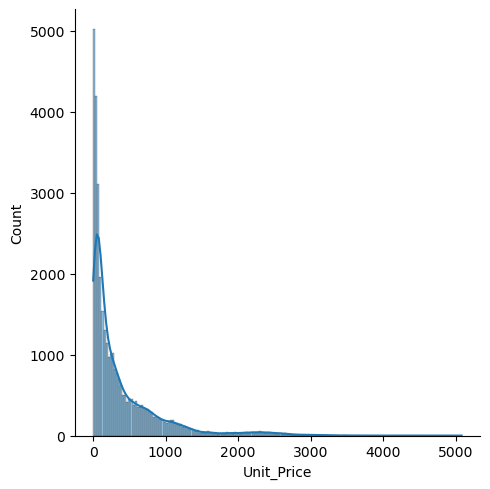

In [52]:
sns.displot(final_data.Unit_Price,kde = True)

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


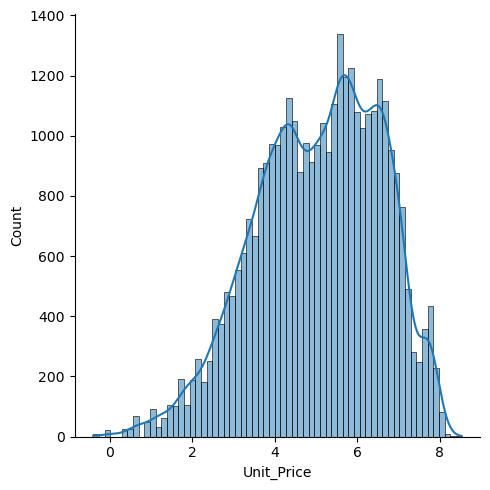

In [53]:
sns.displot(np.log(final_data.Unit_Price),kde = True)

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


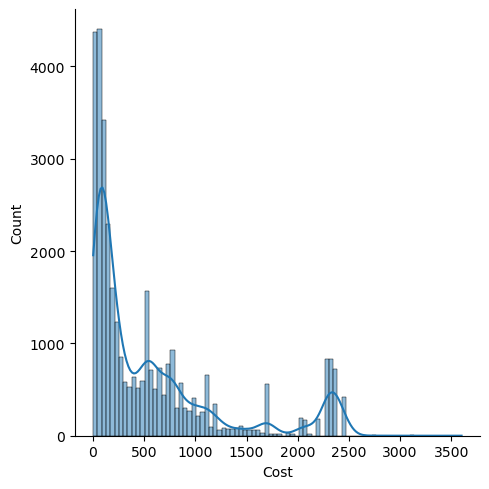

In [54]:
sns.displot(final_data.Cost,kde = True)

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


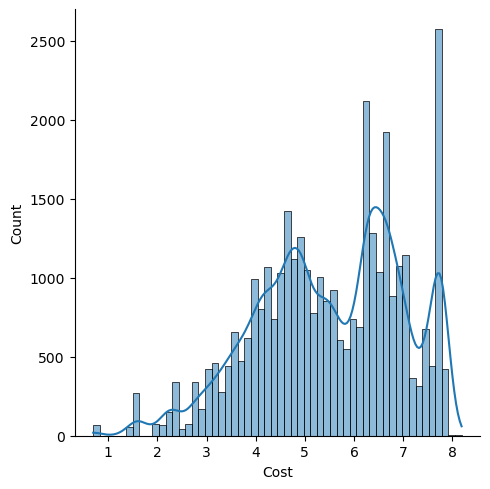

In [55]:
sns.displot(np.log(final_data.Cost),kde = True)

In [56]:
final_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,0,1,0,0
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,0,1,0,0
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,0,1,0,0


In [57]:
final_data_copy = final_data.copy()

In [58]:
final_data_copy['log_rev'] = np.log(final_data_copy['Revenue'])

In [59]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,1,0,0,4.691348
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,4.043051
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,1,0,0,2.708050
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,1,0,0,5.451038
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,1,0,0,4.828314


In [60]:
final_data_copy = final_data_copy.drop(columns='Revenue')

In [61]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,index,Customer_Gender_F,Customer_Gender_M,Country_France,...,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev
0,2016,29,1,80.00,109.000000,80,0,1,0,0,...,0,0,0,0,0,0,1,0,0,4.691348
1,2016,29,2,24.50,28.500000,49,1,1,0,0,...,0,0,0,0,0,0,0,0,0,4.043051
2,2016,29,3,3.67,5.000000,11,2,1,0,0,...,0,0,0,0,0,0,1,0,0,2.708050
3,2016,29,2,87.50,116.500000,175,3,1,0,0,...,0,0,0,0,0,0,1,0,0,5.451038
4,2016,29,3,35.00,41.666667,105,4,1,0,0,...,0,0,0,0,0,0,1,0,0,4.828314


In [62]:
final_data_copy['log_uc'] = np.log(final_data_copy['Unit_Cost'])

In [63]:
final_data_copy['log_up'] = np.log(final_data_copy['Unit_Price'])

In [64]:
final_data_copy['log_Cost'] = np.log(final_data_copy['Cost'])

In [65]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,index,Customer_Gender_F,Customer_Gender_M,Country_France,...,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,80.00,109.000000,80,0,1,0,0,...,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,24.50,28.500000,49,1,1,0,0,...,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820
2,2016,29,3,3.67,5.000000,11,2,1,0,0,...,0,0,0,1,0,0,2.708050,1.300192,1.609438,2.397895
3,2016,29,2,87.50,116.500000,175,3,1,0,0,...,0,0,0,1,0,0,5.451038,4.471639,4.757891,5.164786
4,2016,29,3,35.00,41.666667,105,4,1,0,0,...,0,0,0,1,0,0,4.828314,3.555348,3.729701,4.653960


In [66]:
final_data_copy = final_data_copy.drop(columns='Unit_Cost')

In [67]:
final_data_copy = final_data_copy.drop(columns='Unit_Price')

In [68]:
final_data_copy = final_data_copy.drop(columns='Cost')

In [69]:
final_data_copy.head()

,Year,Customer_Age,Quantity,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,...,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,0,1,0,0,0,0,1,...,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,1,1,0,0,0,0,1,...,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820
2,2016,29,3,2,1,0,0,0,0,1,...,0,0,0,1,0,0,2.708050,1.300192,1.609438,2.397895
3,2016,29,2,3,1,0,0,0,0,1,...,0,0,0,1,0,0,5.451038,4.471639,4.757891,5.164786
4,2016,29,3,4,1,0,0,0,0,1,...,0,0,0,1,0,0,4.828314,3.555348,3.729701,4.653960


In [70]:
final_data.head()

,Year,Customer_Age,Quantity,Unit_Cost,Unit_Price,Cost,Revenue,index,Customer_Gender_F,Customer_Gender_M,...,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests
0,2016,29,1,80.00,109.000000,80,109,0,1,0,...,0,0,0,0,0,0,0,1,0,0
1,2016,29,2,24.50,28.500000,49,57,1,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2016,29,3,3.67,5.000000,11,15,2,1,0,...,0,0,0,0,0,0,0,1,0,0
3,2016,29,2,87.50,116.500000,175,233,3,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2016,29,3,35.00,41.666667,105,125,4,1,0,...,0,0,0,0,0,0,0,1,0,0


## Feature Engineering

### Correlation Analysis

In [71]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [72]:
final_data = final_data.drop(columns = 'index')

In [73]:
corr = final_data.corrwith(final_data.Revenue).abs().sort_values(ascending = False)

In [74]:
corr

Revenue                           1.000000
Cost                              0.979119
Unit_Price                        0.851031
Unit_Cost                         0.836954
Product_Category_Bikes            0.671301
Product_Category_Accessories      0.571720
Sub_Category_Mountain Bikes       0.495436
Sub_Category_Tires and Tubes      0.355591
Sub_Category_Touring Bikes        0.311153
Sub_Category_Bottles and Cages    0.291150
Sub_Category_Road Bikes           0.274725
Sub_Category_Caps                 0.136701
Sub_Category_Shorts               0.100577
Country_Germany                   0.099667
Country_United States             0.094052
Sub_Category_Jerseys              0.092483
Sub_Category_Cleaners             0.083618
Sub_Category_Vests                0.069759
Sub_Category_Socks                0.065905
Sub_Category_Hydration Packs      0.054926
Sub_Category_Bike Racks           0.053693
State_Washington                  0.050444
State_Saarland                    0.047707
State_Calif

In [75]:
v = corr[np.abs(corr)>0.09].index.difference(['Revenue'])

In [76]:
v

Index(['Cost', 'Country_Germany', 'Country_United States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Sub_Category_Bottles and Cages', 'Sub_Category_Caps',
       'Sub_Category_Jerseys', 'Sub_Category_Mountain Bikes',
       'Sub_Category_Road Bikes', 'Sub_Category_Shorts',
       'Sub_Category_Tires and Tubes', 'Sub_Category_Touring Bikes',
       'Unit_Cost', 'Unit_Price'],
      dtype='object')

In [77]:
final_data_2 = final_data.loc[ : : ,['Cost', 'Country_Germany', 'Country_United States','Product_Category_Accessories', 'Product_Category_Bikes','Sub_Category_Bottles and Cages', 'Sub_Category_Caps','Sub_Category_Jerseys', 'Sub_Category_Mountain Bikes','Sub_Category_Road Bikes', 'Sub_Category_Shorts','Sub_Category_Tires and Tubes', 'Sub_Category_Touring Bikes','Unit_Cost', 'Unit_Price']]

In [78]:
final_data_2.head()

,Cost,Country_Germany,Country_United States,Product_Category_Accessories,Product_Category_Bikes,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Unit_Cost,Unit_Price
0,80,0,1,1,0,0,0,0,0,0,0,1,0,80.00,109.000000
1,49,0,1,0,0,0,0,0,0,0,0,0,0,24.50,28.500000
2,11,0,1,1,0,0,0,0,0,0,0,1,0,3.67,5.000000
3,175,0,1,1,0,0,0,0,0,0,0,1,0,87.50,116.500000
4,105,0,1,1,0,0,0,0,0,0,0,1,0,35.00,41.666667


In [79]:
final_data_2.shape

(34865, 15)

In [80]:
final_data_2.columns=[i.replace(' ','_')for i in final_data_2.columns ]

In [81]:
final_data_2.columns

Index(['Cost', 'Country_Germany', 'Country_United_States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Sub_Category_Bottles_and_Cages', 'Sub_Category_Caps',
       'Sub_Category_Jerseys', 'Sub_Category_Mountain_Bikes',
       'Sub_Category_Road_Bikes', 'Sub_Category_Shorts',
       'Sub_Category_Tires_and_Tubes', 'Sub_Category_Touring_Bikes',
       'Unit_Cost', 'Unit_Price'],
      dtype='object')

In [82]:
final_data_2.head()

,Cost,Country_Germany,Country_United_States,Product_Category_Accessories,Product_Category_Bikes,Sub_Category_Bottles_and_Cages,Sub_Category_Caps,Sub_Category_Jerseys,Sub_Category_Mountain_Bikes,Sub_Category_Road_Bikes,Sub_Category_Shorts,Sub_Category_Tires_and_Tubes,Sub_Category_Touring_Bikes,Unit_Cost,Unit_Price
0,80,0,1,1,0,0,0,0,0,0,0,1,0,80.00,109.000000
1,49,0,1,0,0,0,0,0,0,0,0,0,0,24.50,28.500000
2,11,0,1,1,0,0,0,0,0,0,0,1,0,3.67,5.000000
3,175,0,1,1,0,0,0,0,0,0,0,1,0,87.50,116.500000
4,105,0,1,1,0,0,0,0,0,0,0,1,0,35.00,41.666667


### Now whatever Feature Engineering we have done for the final data, we will do the same for final_data_copy.

In [83]:
final_data_copy.head(2)

,Year,Customer_Age,Quantity,index,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September,State_Alabama,State_Arizona,State_Bayern,State_Brandenburg,State_California,State_Charente-Maritime,State_England,State_Essonne,State_Florida,State_Garonne (Haute),State_Georgia,State_Hamburg,State_Hauts de Seine,State_Hessen,State_Illinois,State_Kentucky,State_Loir et Cher,State_Loiret,State_Massachusetts,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Moselle,State_New York,State_Nord,State_Nordrhein-Westfalen,State_North Carolina,State_Ohio,State_Oregon,State_Pas de Calais,State_Saarland,State_Seine (Paris),State_Seine Saint Denis,State_Seine et Marne,State_Somme,State_South Carolina,State_Texas,State_Utah,State_Val d'Oise,State_Val de Marne,State_Virginia,State_Washington,State_Wyoming,State_Yveline,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bike Racks,Sub_Category_Bike Stands,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Fenders,Sub_Category_Gloves,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,1,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820


In [84]:
corr2 = final_data_copy.corrwith(final_data_copy.log_rev).abs().sort_values(ascending = False)
corr2

log_rev                           1.000000
log_Cost                          0.994874
log_up                            0.954347
log_uc                            0.951253
Product_Category_Bikes            0.549326
Product_Category_Accessories      0.520417
Sub_Category_Tires and Tubes      0.405093
Sub_Category_Mountain Bikes       0.354248
Sub_Category_Bottles and Cages    0.313683
Sub_Category_Road Bikes           0.287113
Sub_Category_Touring Bikes        0.234972
Sub_Category_Jerseys              0.147743
Sub_Category_Helmets              0.142365
Sub_Category_Caps                 0.115426
Sub_Category_Shorts               0.103767
Product_Category_Clothing         0.077479
Sub_Category_Vests                0.076255
Sub_Category_Cleaners             0.075522
Country_Germany                   0.075154
Sub_Category_Hydration Packs      0.074524
Country_United States             0.072431
index                             0.071367
Sub_Category_Socks                0.054987
Sub_Categor

In [85]:
final_data_copy = final_data_copy.drop(columns = 'index')

**We are taking a cut-off of 0.07 as per looking at the correlation values and we wanted at max 25 variables as per the data.**

In [86]:
w = corr2[np.abs(corr2)>0.07].index.difference(['log_rev'])
w

Index(['Country_Germany', 'Country_United States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Product_Category_Clothing', 'Sub_Category_Bottles and Cages',
       'Sub_Category_Caps', 'Sub_Category_Cleaners', 'Sub_Category_Helmets',
       'Sub_Category_Hydration Packs', 'Sub_Category_Jerseys',
       'Sub_Category_Mountain Bikes', 'Sub_Category_Road Bikes',
       'Sub_Category_Shorts', 'Sub_Category_Tires and Tubes',
       'Sub_Category_Touring Bikes', 'Sub_Category_Vests', 'index', 'log_Cost',
       'log_uc', 'log_up'],
      dtype='object')

In [87]:
fd_copy2 = final_data_copy.loc[ : : ,['Country_Germany', 'Country_United States','Product_Category_Accessories', 'Product_Category_Bikes','Product_Category_Clothing', 'Sub_Category_Bottles and Cages','Sub_Category_Caps', 'Sub_Category_Cleaners', 'Sub_Category_Helmets','Sub_Category_Hydration Packs', 'Sub_Category_Jerseys','Sub_Category_Mountain Bikes', 'Sub_Category_Road Bikes','Sub_Category_Shorts', 'Sub_Category_Tires and Tubes','Sub_Category_Touring Bikes', 'Sub_Category_Vests', 'log_Cost','log_uc', 'log_up']]

In [88]:
fd_copy2.head(3)

,Country_Germany,Country_United States,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_Cost,log_uc,log_up
0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.382027,4.382027,4.691348
1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,3.891820,3.198673,3.349904
2,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2.397895,1.300192,1.609438


In [89]:
fd_copy2.shape

(34865, 20)

In [90]:
fd_copy2.columns=[i.replace(' ','_')for i in fd_copy2.columns]

In [91]:
fd_copy2.columns

Index(['Country_Germany', 'Country_United_States',
       'Product_Category_Accessories', 'Product_Category_Bikes',
       'Product_Category_Clothing', 'Sub_Category_Bottles_and_Cages',
       'Sub_Category_Caps', 'Sub_Category_Cleaners', 'Sub_Category_Helmets',
       'Sub_Category_Hydration_Packs', 'Sub_Category_Jerseys',
       'Sub_Category_Mountain_Bikes', 'Sub_Category_Road_Bikes',
       'Sub_Category_Shorts', 'Sub_Category_Tires_and_Tubes',
       'Sub_Category_Touring_Bikes', 'Sub_Category_Vests', 'log_Cost',
       'log_uc', 'log_up'],
      dtype='object')

## Splitting the final dataset into Training and Testing dataset

In [92]:
!pip install scikit-learn

Defaulting to user installation because normal site-packages is not writeable


In [93]:
import sklearn

In [94]:
from sklearn.model_selection import train_test_split

In [95]:
final_data_2['Revenue'] = final_data['Revenue']

In [96]:
train,test = train_test_split(final_data_2,test_size = 0.3, random_state = 123)

In [97]:
train.shape

(24405, 16)

In [98]:
test.shape

(10460, 16)

In [99]:
#Just do train-test split for the new data.

In [100]:
fd_copy2['log_Revenue'] = final_data_copy['log_rev']

In [101]:
log_train,log_test = train_test_split(fd_copy2,test_size = 0.3, random_state = 123)

In [102]:
log_train.shape

(24405, 21)

In [103]:
log_test.shape

(10460, 21)

## Building the Regression model

In [104]:
formula = 'Revenue~' + '+'.join(train.columns.difference(['Revenue']))

In [105]:
formula2 = 'Revenue~' + '+'.join(train.columns.difference(['Revenue','Product_Category_Accessories']))

In [106]:
form3 = 'Revenue~' + '+'.join(train.columns.difference(['Revenue','Product_Category_Accessories','Sub_Category_Shorts']))

In [107]:
form4 = 'Revenue~' + '+'.join(train.columns.difference(['Revenue','Product_Category_Accessories','Sub_Category_Shorts','Sub_Category_Jerseys']))

In [108]:
from sklearn import datasets, linear_model

In [109]:
formula 

'Revenue~Cost+Country_Germany+Country_United_States+Product_Category_Accessories+Product_Category_Bikes+Sub_Category_Bottles_and_Cages+Sub_Category_Caps+Sub_Category_Jerseys+Sub_Category_Mountain_Bikes+Sub_Category_Road_Bikes+Sub_Category_Shorts+Sub_Category_Tires_and_Tubes+Sub_Category_Touring_Bikes+Unit_Cost+Unit_Price'

In [110]:
model = smf.ols(form4, train).fit()

In [111]:
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                Revenue   R-squared:                       0.993
Model:                            OLS   Adj. R-squared:                  0.993
Method:                 Least Squares   F-statistic:                 3.150e+05
Date:                Fri, 24 May 2024   Prob (F-statistic):               0.00
Time:                        08:29:25   Log-Likelihood:            -1.3520e+05
No. Observations:               24405   AIC:                         2.704e+05
Df Residuals:                   24393   BIC:                         2.705e+05
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

In [112]:
pred_Revenue = model.predict(train)
pred_Revenue

5858      162.568496
2839     2308.953804
1188       91.252414
7144      544.185137
30585     157.412994
3745     1118.906421
10182     101.454413
27770     117.031752
7266     2021.608158
29410     319.888549
22362    1695.732201
26692     678.528721
34751      70.626739
24810     107.856922
11594     631.007111
28422      75.232500
14150    2466.680546
13682      40.521191
22402     999.770009
23667     343.009220
961       241.725145
27876    2856.147850
3124      249.630789
3609      514.986893
30936     208.127089
21746     565.557487
29281     709.223483
28206    2442.477783
28632     243.113025
25235     829.873859
5054      797.251606
24277      40.328345
7830     1860.096764
33558      96.342717
20718     160.742569
16437     179.094092
5609       82.181625
7578      274.237284
19448     667.809448
18837    1854.038160
7450      247.469871
14194      52.583511
25452     139.285423
11159     418.540142
13070     584.496994
9917     1563.606986
15158     486.941714
28167     974

In [113]:
train['Revenue']

5858      162
2839     2109
1188       73
7144      555
30585     148
3745     1224
10182      95
27770     124
7266     2261
29410     360
22362    1559
26692     725
34751      71
24810     106
11594     633
28422      85
14150    2485
13682      47
22402     990
23667     387
961       214
27876    2809
3124      254
3609      510
30936     196
21746     622
29281     684
28206    2328
28632     202
25235     855
5054      791
24277      43
7830     2002
33558      83
20718     148
16437     179
5609       79
7578      269
19448     628
18837    1763
7450      227
14194      56
25452     127
11159     427
13070     548
9917     1630
15158     498
28167    1043
14894    1271
11187    1045
18081     918
21085     116
17272     517
16675      10
19282     423
18309      96
26797      52
9409      268
22609      42
4729      180
23602      89
24581     116
10790     157
21118     236
4913      618
28539     673
27921      44
3194     2808
5120       81
11772      32
5795      481
34505 

In [114]:
Result = pd.DataFrame(pd.concat([train['Revenue'],pred_Revenue],axis = 1))

In [115]:
Result = Result.rename(columns = {0:'Prediction'})

In [116]:
Result.head()

,Revenue,Prediction
5858,162,162.568496
2839,2109,2308.953804
1188,73,91.252414
7144,555,544.185137
30585,148,157.412994


In [117]:
Result['Error'] = np.abs(Result['Revenue'] - Result['Prediction'])

In [118]:
Result.head()

,Revenue,Prediction,Error
5858,162,162.568496,0.568496
2839,2109,2308.953804,199.953804
1188,73,91.252414,18.252414
7144,555,544.185137,10.814863
30585,148,157.412994,9.412994


In [119]:
Result['Percent_Error'] = (Result['Error']/Result['Revenue'])*100

In [120]:
Result.head()

,Revenue,Prediction,Error,Percent_Error
5858,162,162.568496,0.568496,0.350924
2839,2109,2308.953804,199.953804,9.480977
1188,73,91.252414,18.252414,25.003307
7144,555,544.185137,10.814863,1.948624
30585,148,157.412994,9.412994,6.360131


In [121]:
MAPE= np.round(np.mean(Result['Percent_Error']),2)
MAPE

9.7

**MAPE error is less than 10-12% (maximum MAPE allowable) so we can say it is a very good regression model**

In [122]:
pred_Reve_test = model.predict(test)
pred_Reve_test

28368     785.628933
17066    1459.873291
25420     180.035066
28605    1087.182212
4850      130.563300
1418     2178.673152
19201     496.903422
23212     153.077964
24198     491.980736
19615    1547.107943
34118     221.182799
17271      58.944975
14638     183.688633
25817      18.459773
8204      942.258989
27022    2350.380867
27115     615.868257
2539       79.610024
2759       94.608276
7894      847.637621
2217      107.774154
31386     747.793227
14558     910.013870
1835      157.043043
1266      820.190547
26584      68.583036
18396     876.693226
20362    1166.727607
14585     101.164761
14876    1740.068686
5344      662.788937
6159     2364.857823
5119      627.692068
28011     542.402571
15694     146.343171
16420     221.419640
783       103.583463
3211     2185.163623
23010     463.363714
20960      84.732121
14837    1008.109299
17939      56.940592
24316     499.058560
20768     197.715332
28359     101.217792
3435      609.206211
6723      253.870819
19613     368

In [123]:
final_data_copy.head()

,Year,Customer_Age,Quantity,Customer_Gender_F,Customer_Gender_M,Country_France,Country_Germany,Country_United Kingdom,Country_United States,Month_April,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September,State_Alabama,State_Arizona,State_Bayern,State_Brandenburg,State_California,State_Charente-Maritime,State_England,State_Essonne,State_Florida,State_Garonne (Haute),State_Georgia,State_Hamburg,State_Hauts de Seine,State_Hessen,State_Illinois,State_Kentucky,State_Loir et Cher,State_Loiret,State_Massachusetts,State_Minnesota,State_Mississippi,State_Missouri,State_Montana,State_Moselle,State_New York,State_Nord,State_Nordrhein-Westfalen,State_North Carolina,State_Ohio,State_Oregon,State_Pas de Calais,State_Saarland,State_Seine (Paris),State_Seine Saint Denis,State_Seine et Marne,State_Somme,State_South Carolina,State_Texas,State_Utah,State_Val d'Oise,State_Val de Marne,State_Virginia,State_Washington,State_Wyoming,State_Yveline,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bike Racks,Sub_Category_Bike Stands,Sub_Category_Bottles and Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Fenders,Sub_Category_Gloves,Sub_Category_Helmets,Sub_Category_Hydration Packs,Sub_Category_Jerseys,Sub_Category_Mountain Bikes,Sub_Category_Road Bikes,Sub_Category_Shorts,Sub_Category_Socks,Sub_Category_Tires and Tubes,Sub_Category_Touring Bikes,Sub_Category_Vests,log_rev,log_uc,log_up,log_Cost
0,2016,29,1,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.691348,4.382027,4.691348,4.382027
1,2016,29,2,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,4.043051,3.198673,3.349904,3.891820
2,2016,29,3,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2.708050,1.300192,1.609438,2.397895
3,2016,29,2,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,5.451038,4.471639,4.757891,5.164786
4,2016,29,3,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.828314,3.555348,3.729701,4.653960


In [124]:
pred_Revenue

5858      162.568496
2839     2308.953804
1188       91.252414
7144      544.185137
30585     157.412994
3745     1118.906421
10182     101.454413
27770     117.031752
7266     2021.608158
29410     319.888549
22362    1695.732201
26692     678.528721
34751      70.626739
24810     107.856922
11594     631.007111
28422      75.232500
14150    2466.680546
13682      40.521191
22402     999.770009
23667     343.009220
961       241.725145
27876    2856.147850
3124      249.630789
3609      514.986893
30936     208.127089
21746     565.557487
29281     709.223483
28206    2442.477783
28632     243.113025
25235     829.873859
5054      797.251606
24277      40.328345
7830     1860.096764
33558      96.342717
20718     160.742569
16437     179.094092
5609       82.181625
7578      274.237284
19448     667.809448
18837    1854.038160
7450      247.469871
14194      52.583511
25452     139.285423
11159     418.540142
13070     584.496994
9917     1563.606986
15158     486.941714
28167     974

In [125]:
final_data_copy['log_rev'] = final_data_copy['log_rev']

In [126]:
final_data_2.head()

,Cost,Country_Germany,Country_United_States,Product_Category_Accessories,Product_Category_Bikes,Sub_Category_Bottles_and_Cages,Sub_Category_Caps,Sub_Category_Jerseys,Sub_Category_Mountain_Bikes,Sub_Category_Road_Bikes,Sub_Category_Shorts,Sub_Category_Tires_and_Tubes,Sub_Category_Touring_Bikes,Unit_Cost,Unit_Price,Revenue
0,80,0,1,1,0,0,0,0,0,0,0,1,0,80.00,109.000000,109
1,49,0,1,0,0,0,0,0,0,0,0,0,0,24.50,28.500000,57
2,11,0,1,1,0,0,0,0,0,0,0,1,0,3.67,5.000000,15
3,175,0,1,1,0,0,0,0,0,0,0,1,0,87.50,116.500000,233
4,105,0,1,1,0,0,0,0,0,0,0,1,0,35.00,41.666667,125


# Building a Regression model on the new dataset:

In [127]:
log_train.head()

,Country_Germany,Country_United_States,Product_Category_Accessories,Product_Category_Bikes,Product_Category_Clothing,Sub_Category_Bottles_and_Cages,Sub_Category_Caps,Sub_Category_Cleaners,Sub_Category_Helmets,Sub_Category_Hydration_Packs,Sub_Category_Jerseys,Sub_Category_Mountain_Bikes,Sub_Category_Road_Bikes,Sub_Category_Shorts,Sub_Category_Tires_and_Tubes,Sub_Category_Touring_Bikes,Sub_Category_Vests,log_Cost,log_uc,log_up,log_Revenue
5858,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,5.075174,5.075174,5.087596,5.087596
2839,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,7.749322,6.650706,6.555357,7.653969
1188,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,3.806662,2.708050,3.191847,4.290459
7144,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,6.291569,5.598422,5.625821,6.318968
30585,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4.828314,4.828314,4.997212,4.997212


In [128]:
log_formula1 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue']))

In [129]:
log_formula2 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States']))

In [130]:
log_formula3 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes']))

In [131]:
log_formula4 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps']))

In [132]:
log_formula5 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps','Country_Germany']))

In [133]:
log_formula6 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps','Country_Germany','Sub_Category_Cleaners']))

In [134]:
log_formula7 = 'log_Revenue~' + '+'.join(log_train.columns.difference(['log_Revenue','Country_United_States','Sub_Category_Tires_and_Tubes','Sub_Category_Caps','Country_Germany','Sub_Category_Cleaners','Sub_Category_Vests']))

In [135]:
log_formula1

'log_Revenue~Country_Germany+Country_United_States+Product_Category_Accessories+Product_Category_Bikes+Product_Category_Clothing+Sub_Category_Bottles_and_Cages+Sub_Category_Caps+Sub_Category_Cleaners+Sub_Category_Helmets+Sub_Category_Hydration_Packs+Sub_Category_Jerseys+Sub_Category_Mountain_Bikes+Sub_Category_Road_Bikes+Sub_Category_Shorts+Sub_Category_Tires_and_Tubes+Sub_Category_Touring_Bikes+Sub_Category_Vests+log_Cost+log_uc+log_up'

In [136]:
model_new = smf.ols(log_formula7, log_train).fit()

In [137]:
print(model_new.summary())

                            OLS Regression Results                            
Dep. Variable:            log_Revenue   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 8.555e+07
Date:                Fri, 24 May 2024   Prob (F-statistic):               0.00
Time:                        08:29:28   Log-Likelihood:                 87225.
No. Observations:               24405   AIC:                        -1.744e+05
Df Residuals:                   24391   BIC:                        -1.743e+05
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

In [139]:
pred_log_rev = model_new.predict(log_train)
pred_log_rev

5858     5.091626
2839     7.657240
1188     4.294557
7144     6.299558
30585    5.001264
3745     7.090477
10182    4.557949
27770    4.824339
7266     7.727119
29410    5.889634
22362    7.332368
26692    6.586641
34751    4.266766
24810    4.667495
11594    6.454499
28422    4.446926
14150    7.821283
13682    3.854240
22402    6.901740
23667    5.961998
961      5.370000
27876    7.941033
3124     5.541386
3609     6.238441
30936    5.282182
21746    6.436244
29281    6.531516
28206    7.753221
28632    5.311833
25235    6.755145
5054     6.673799
24277    3.765271
7830     7.605151
33558    4.422909
20718    5.001274
16437    5.191372
5609     4.373522
7578     5.598722
19448    6.446105
18837    7.478317
7450     5.429015
14194    4.029659
25452    4.848268
11159    6.060853
13070    6.310328
9917     7.376888
15158    6.214645
28167    6.953903
14894    7.148030
11187    6.955813
18081    6.802772
21085    4.757546
17272    6.252078
16675    2.306219
19282    6.051483
18309    4

In [141]:
predicted_revenue= np.exp(pred_log_rev)

In [143]:
predicted_revenue=np.round(predicted_revenue,3)

In [144]:
predicted_revenue

5858      162.654
2839     2115.909
1188       73.300
7144      544.331
30585     148.601
3745     1200.480
10182      95.388
27770     124.504
7266     2269.056
29410     361.273
22362    1528.998
26692     725.340
34751      71.291
24810     106.431
11594     635.555
28422      85.364
14150    2493.102
13682      47.193
22402     994.003
23667     388.385
961       214.863
27876    2810.261
3124      255.031
3609      512.060
30936     196.799
21746     624.058
29281     686.438
28206    2329.062
28632     202.721
25235     858.464
5054      791.396
24277      43.175
7830     2008.516
33558      83.338
20718     148.602
16437     179.715
5609       79.323
7578      270.081
19448     630.243
18837    1769.261
7450      227.925
14194      56.242
25452     127.519
11159     428.741
13070     550.226
9917     1598.608
15158     500.018
28167    1047.229
14894    1271.598
11187    1049.231
18081     900.340
21085     116.460
17272     519.090
16675      10.036
19282     424.742
18309     

In [145]:
Result_2 = pd.DataFrame(pd.concat([train['Revenue'],predicted_revenue],axis = 1))

In [146]:
Result_2 

,Revenue,0
5858,162,162.654
2839,2109,2115.909
1188,73,73.300
7144,555,544.331
30585,148,148.601
3745,1224,1200.480
10182,95,95.388
27770,124,124.504
7266,2261,2269.056
29410,360,361.273


In [147]:
Result_2 = Result_2.rename(columns = {0:'Prediction'})

In [148]:
Result_2

,Revenue,Prediction
5858,162,162.654
2839,2109,2115.909
1188,73,73.300
7144,555,544.331
30585,148,148.601
3745,1224,1200.480
10182,95,95.388
27770,124,124.504
7266,2261,2269.056
29410,360,361.273


In [149]:
Result_2['Error'] = np.abs(Result_2['Revenue'] - Result_2['Prediction'])

In [150]:
Result_2['Percent_Error'] = (Result_2['Error']/Result_2['Revenue'])*100

In [151]:
Result_2

,Revenue,Prediction,Error,Percent_Error
5858,162,162.654,0.654,0.403704
2839,2109,2115.909,6.909,0.327596
1188,73,73.300,0.300,0.410959
7144,555,544.331,10.669,1.922342
30585,148,148.601,0.601,0.406081
3745,1224,1200.480,23.520,1.921569
10182,95,95.388,0.388,0.408421
27770,124,124.504,0.504,0.406452
7266,2261,2269.056,8.056,0.356303
29410,360,361.273,1.273,0.353611


In [152]:
MAPE_2= np.round(np.mean(Result_2['Percent_Error']),2)
MAPE_2

0.51

In [153]:
pred_test=model_new.predict(log_test)

In [154]:
pred_test=np.exp(pred_test)

In [155]:
pred_test

28368     767.074781
17066    1536.409706
25420     172.698376
28605     970.916262
4850      137.546807
1418     2268.364957
19201     459.511943
23212     134.478913
24198     483.943837
19615    1528.406175
34118     239.971973
17271      58.208544
14638     178.736680
25817      10.028829
8204      925.720280
27022    2108.955902
27115     636.530564
2539       60.260676
2759      101.398817
7894      911.996316
2217      107.434655
31386     793.596388
14558     711.058793
1835      174.706644
1266      875.876732
26584      59.242616
18396     982.959526
20362    1149.453131
14585      80.290037
14876    1677.086430
5344      623.515233
6159     2183.132196
5119      604.427723
28011     531.153563
15694     144.504625
16420     251.027398
783        68.278493
3211     2162.050660
23010     425.654437
20960      74.266445
14837    1185.231927
17939      63.256926
24316     506.036889
20768     175.624861
28359     106.432820
3435      603.179372
6723      237.959969
19613     383

In [156]:
Result_2_test = pd.DataFrame(pd.concat([test['Revenue'],pred_test],axis = 1))

In [157]:
Result_2_test

,Revenue,0
28368,764,767.074781
17066,1531,1536.409706
25420,172,172.698376
28605,967,970.916262
4850,137,137.546807
1418,2261,2268.364957
19201,458,459.511943
23212,134,134.478913
24198,482,483.943837
19615,1523,1528.406175


In [158]:
Result_2_test = Result_2_test.rename(columns = {0:'Prediction'})
Result_2_test['Error'] = np.abs(Result_2_test['Revenue'] - Result_2_test['Prediction'])
Result_2_test['Percent_Error'] = (Result_2_test['Error']/Result_2_test['Revenue'])*100

In [159]:
Result_2_test

,Revenue,Prediction,Error,Percent_Error
28368,764,767.074781,3.074781,0.402458
17066,1531,1536.409706,5.409706,0.353345
25420,172,172.698376,0.698376,0.406033
28605,967,970.916262,3.916262,0.404991
4850,137,137.546807,0.546807,0.399129
1418,2261,2268.364957,7.364957,0.325739
19201,458,459.511943,1.511943,0.330119
23212,134,134.478913,0.478913,0.357398
24198,482,483.943837,1.943837,0.403286
19615,1523,1528.406175,5.406175,0.354969


In [160]:
MAPE_2_test= np.round(np.mean(Result_2_test['Percent_Error']),2)
MAPE_2_test

0.51

In [161]:
print("Training Dataset MAPE error:",MAPE_2)
print("Testing Dataset MAPE error:",MAPE_2_test)

Training Dataset MAPE error: 0.51
Testing Dataset MAPE error: 0.51


**Model_new is a perfect Regression model with Zero overfitting it. R Square value is 100%**